In [3]:
from yahoo_fin.stock_info import get_data
from datetime import date
import plotly.express as px
import pandas as pd
import numpy as np
from pathlib import Path
import csv
import plotly.graph_objects as go
import plotly.figure_factory as ff
import matplotlib.pyplot as plt
import panel as pn
from panel.interact import interact
from MCForecastTools import MCSimulation
pn.extension("plotly")
%matplotlib inline

In [4]:
portfolio_returns = pd.read_csv(r'data/portfolio_returns.csv').set_index('Date')
combined_portfolios = pd.read_csv(r'data/combined_portfolios.csv').set_index('Date')
combined_returns = pd.read_csv(r'data/combined_returns.csv').set_index('Date')
monte_carlo_df = combined_portfolios.dropna()
monte_carlo_dataframe = pd.read_csv(r'data/monte_carlo_dataframe.csv')
monte_carlo_dataframe = monte_carlo_dataframe.rename({'Unnamed: 0': 'Date'}, axis=1)
monte_carlo_dataframe = monte_carlo_dataframe.set_index('Date')
index_names = [
["BTC", "ETH", "SPY", "TLT", "GLD", "USD", "XLE", "XLF"],
["close", "close","close","close","close","close","close","close"]
# ["BTC", "ETH", "SPY", "TLT", "GLD", "USD"],
# ["close", "close","close","close","close","close"]
]
index_tuples = list(zip(*index_names))
new_index = pd.MultiIndex.from_tuples(index_tuples,names=["first", "second"])
monte_carlo_dataframe.columns = new_index

monte_carlo_dataframe

first,BTC,ETH,SPY,TLT,GLD,USD,XLE,XLF
second,close,close,close,close,close,close,close,close
Date,,,,,,,,
2016-01-04,433.091003,0.954480,201.020004,102.889999,121.449997,98.870003,60.299999,18.984566
2016-01-05,431.959991,0.950176,201.360001,103.180000,120.959999,99.400002,60.529999,19.057676
2016-01-06,429.105011,0.950860,198.820007,104.669998,122.589996,99.180000,58.200001,18.765232
2016-01-07,458.048004,0.942005,194.050003,106.150002,122.809998,98.220001,56.779999,18.237206
2016-01-08,453.230011,0.986789,191.919998,105.680000,123.360001,98.540001,56.049999,17.952885
2016-01-11,448.428009,1.061600,192.110001,104.739998,122.010002,98.730003,54.849998,17.977255
2016-01-12,435.690002,1.141000,193.660004,104.209999,123.769997,98.970001,54.980000,18.115353
2016-01-13,432.371002,1.125200,188.830002,104.720001,124.989998,98.930000,53.660000,17.644192


In [5]:
def get_port_returns_graph():
    port_returns_fig = px.line(portfolio_returns)
    port_returns_fig.update_layout(
    title='Volatility',
    paper_bgcolor='rgb(243, 243, 243)',
    plot_bgcolor='rgb(243, 243, 243)',
    showlegend=True
    )
    return port_returns_fig.show()

def get_vol_graph():
    cumulative_returns = (1 + portfolio_returns).cumprod()
    volatility_fig = px.line(cumulative_returns)
    volatility_fig.update_layout(
        title='Volatility',
        paper_bgcolor='rgb(243, 243, 243)',
        plot_bgcolor='rgb(243, 243, 243)',
        showlegend=True
    )
    return volatility_fig.show()

def get_vol_box():
    vol_box_fig = go.Figure()
    vol_box_fig.add_trace(go.Box(y=portfolio_returns['BTC'], name='Bitcoin',
                    marker_color = 'indianred', boxpoints=False))
    vol_box_fig.add_trace(go.Box(y=portfolio_returns['ETH'], name = 'Ethereum',
                    marker_color = 'lightseagreen', boxpoints=False))
    vol_box_fig.add_trace(go.Box(y=portfolio_returns['SPY'], name='S&P 500',
                    marker_color = 'blue', boxpoints=False))
    vol_box_fig.add_trace(go.Box(y=portfolio_returns['TLT'], name = 'Bonds (TLT)',
                    marker_color = 'grey', boxpoints=False))
    vol_box_fig.add_trace(go.Box(y=portfolio_returns['USD'], name = 'US Dollar',
                    marker_color = 'green', boxpoints=False))
    vol_box_fig.add_trace(go.Box(y=portfolio_returns['GLD'], name='Gold',
                    marker_color = 'gold', boxpoints=False))
    vol_box_fig.add_trace(go.Box(y=portfolio_returns['XLE'], name = 'Energy (XLE)',
                    marker_color = 'red', boxpoints=False))
    vol_box_fig.add_trace(go.Box(y=portfolio_returns['XLF'], name = 'Financials (XLF)',
                    marker_color = 'black', boxpoints=False))

    vol_box_fig.update_layout(
        title='Daily Return Distributions',
        paper_bgcolor='rgb(243, 243, 243)',
        plot_bgcolor='rgb(243, 243, 243)',
        showlegend=False
    )

    return vol_box_fig.show()

def get_rolling():
    # Calculate the rolling standard deviation for all portfolios using a 21-day window
    roll = portfolio_returns.rolling(window=120).std()
    # Plot the rolling standard deviation
    roll_120_fig = px.line(roll)
    roll_120_fig.update_layout(
        title='Rolling Returns',
        paper_bgcolor='rgb(243, 243, 243)',
        plot_bgcolor='rgb(243, 243, 243)',
        showlegend=True
    )
    return roll_120_fig.show()

def get_ewm():
    ewm_calc = portfolio_returns.ewm(halflife=120).std()
    roll_120_line_fig = px.line(ewm_calc)
    roll_120_line_fig.update_layout(
        title='Rolling Returns',
        paper_bgcolor='rgb(243, 243, 243)',
        plot_bgcolor='rgb(243, 243, 243)',
        showlegend=True
    )
    return roll_120_line_fig.show()

def get_sharpe_ratios():
    sharpe_ratios = (portfolio_returns.mean() * 252) / (portfolio_returns.std() * np.sqrt(252))
    sharpe_bar_fig = px.bar(sharpe_ratios,labels=dict(x="Assets", y="Sharpe Ratio", color="Sharpe Ratio"),color = sharpe_ratios, color_continuous_scale='Bluered_r')
    sharpe_bar_fig.update_layout(
    title='Sharpe Ratios',
    paper_bgcolor='rgb(243, 243, 243)',
    plot_bgcolor='rgb(243, 243, 243)',
    showlegend=True
    )
    return sharpe_bar_fig.show()

def get_correlation():
    price_correlation_new = portfolio_returns.corr()
    heatmap_fig = px.imshow(price_correlation_new, color_continuous_scale='Bluered_r', labels = dict(color='Corerelation'))
    heatmap_fig.update_layout(
        title='Individual Asset Correlations',
        paper_bgcolor='rgb(243, 243, 243)',
        plot_bgcolor='rgb(243, 243, 243)',
        showlegend=True
    )
    return heatmap_fig.show()

def get_cumulative_portfolios():
    cum_returns = px.line(combined_portfolios)
    cum_returns.update_layout(
    title='5 Year Cumulative Portfolio Returns',
    paper_bgcolor='rgb(243, 243, 243)',
    plot_bgcolor='rgb(243, 243, 243)',
    showlegend=True
    )
    return cum_returns.show()

def get_portfolio_sharpe_ratios():
    portfolio_sharpe_ratios = (combined_returns.mean() * 252) / (combined_returns.std() * np.sqrt(252))
    portfolio_sharpe_fig = px.bar(portfolio_sharpe_ratios,labels=dict(x="Assets", y="Sharpe Ratio", color="Sharpe Ratio"),color = portfolio_sharpe_ratios, color_continuous_scale='Bluered_r')
    portfolio_sharpe_fig.update_layout(
        title='Portoflio Sharpe Ratios',
        paper_bgcolor='rgb(243, 243, 243)',
        plot_bgcolor='rgb(243, 243, 243)',
        showlegend=True
    )
    return portfolio_sharpe_fig.show()

def get_traditional_mc():
    mc_traditional = MCSimulation(
    monte_carlo_dataframe,
    weights = [0,0,0.50,0.40,0.05,0.05,0,0],
    num_simulation = 200,
    num_trading_days = 252*5)
    mc_trad_px = mc_traditional.calc_cumulative_return()
    mc_trad_fig = px.line(mc_trad_px)
    mc_trad_fig.update_layout(
        title='Traditional Portfolio Monte Carlo Simulation',
        paper_bgcolor='rgb(243, 243, 243)',
        plot_bgcolor='rgb(243, 243, 243)',
        showlegend=True
    )
    mc_trad_fig.show()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.


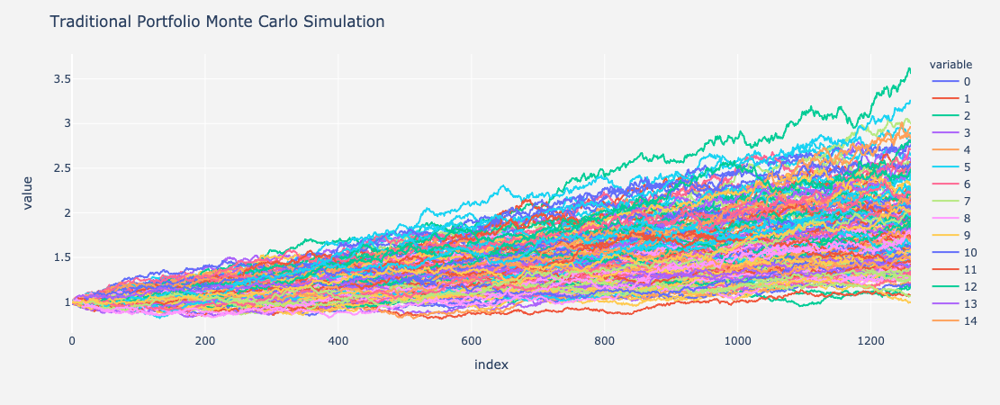

In [6]:
get_traditional_mc()